# Transform 이해하기!

In [1]:
import os
from glob import glob

import torch
import torch.nn as nn
import torch.nn.functional as F
from torchvision import datasets, transforms

import numpy as np
import matplotlib.pyplot as plt
from PIL import Image

In [3]:
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
device

device(type='cpu')

In [4]:
image = Image.open("D:/zbDS/Project/Part8_DL/_dataset/sample.jpg")
np.array(image).shape

(1029, 1280, 3)

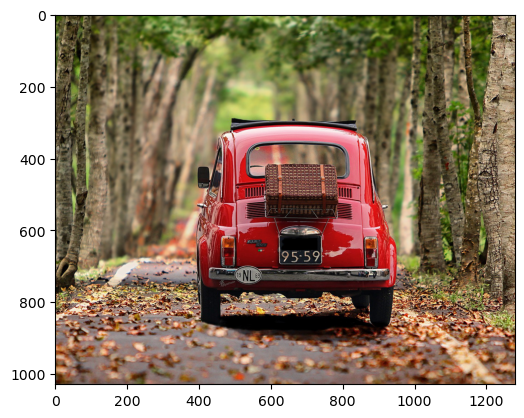

In [5]:
plt.imshow(image)
plt.show()

In [7]:
dir(transforms)

['AugMix',
 'AutoAugment',
 'AutoAugmentPolicy',
 'CenterCrop',
 'ColorJitter',
 'Compose',
 'ConvertImageDtype',
 'ElasticTransform',
 'FiveCrop',
 'GaussianBlur',
 'Grayscale',
 'InterpolationMode',
 'Lambda',
 'LinearTransformation',
 'Normalize',
 'PILToTensor',
 'Pad',
 'RandAugment',
 'RandomAdjustSharpness',
 'RandomAffine',
 'RandomApply',
 'RandomAutocontrast',
 'RandomChoice',
 'RandomCrop',
 'RandomEqualize',
 'RandomErasing',
 'RandomGrayscale',
 'RandomHorizontalFlip',
 'RandomInvert',
 'RandomOrder',
 'RandomPerspective',
 'RandomPosterize',
 'RandomResizedCrop',
 'RandomRotation',
 'RandomSolarize',
 'RandomVerticalFlip',
 'Resize',
 'TenCrop',
 'ToPILImage',
 'ToTensor',
 'TrivialAugmentWide',
 '__builtins__',
 '__cached__',
 '__doc__',
 '__file__',
 '__loader__',
 '__name__',
 '__package__',
 '__path__',
 '__spec__',
 '_functional_pil',
 '_functional_tensor',
 '_presets',
 'autoaugment',
 'functional',
 'transforms']

## Transform on Tensor

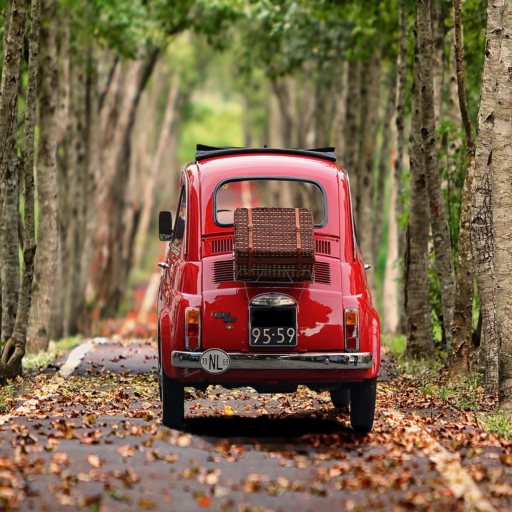

In [8]:
transforms.Resize((512, 512))(image)

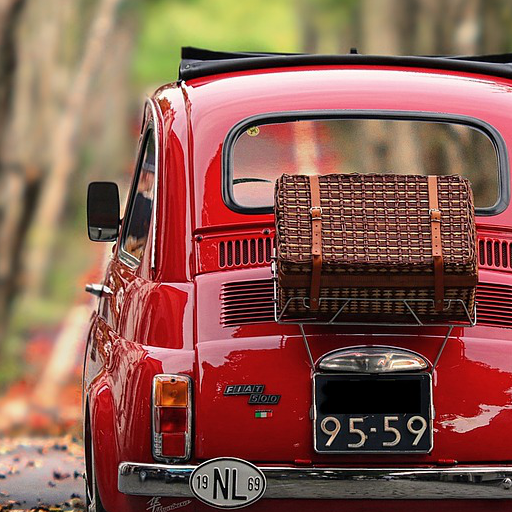

In [9]:
transforms.RandomCrop(size=(512,512))(image)

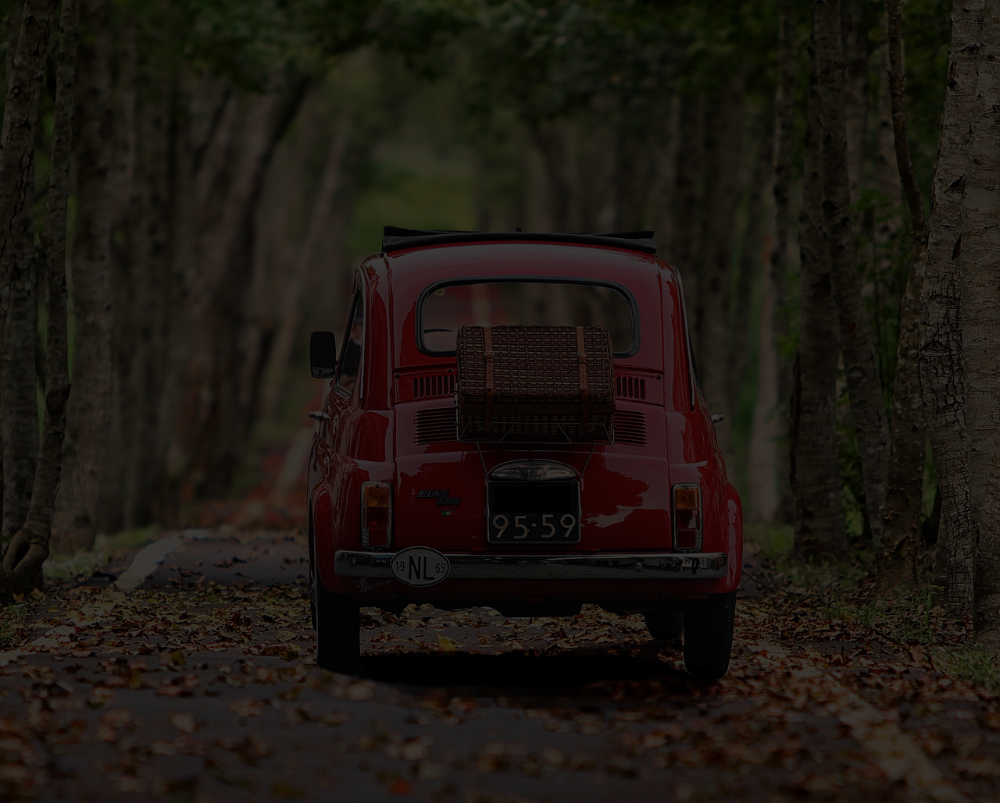

In [11]:
transforms.ColorJitter(brightness=1)(image)

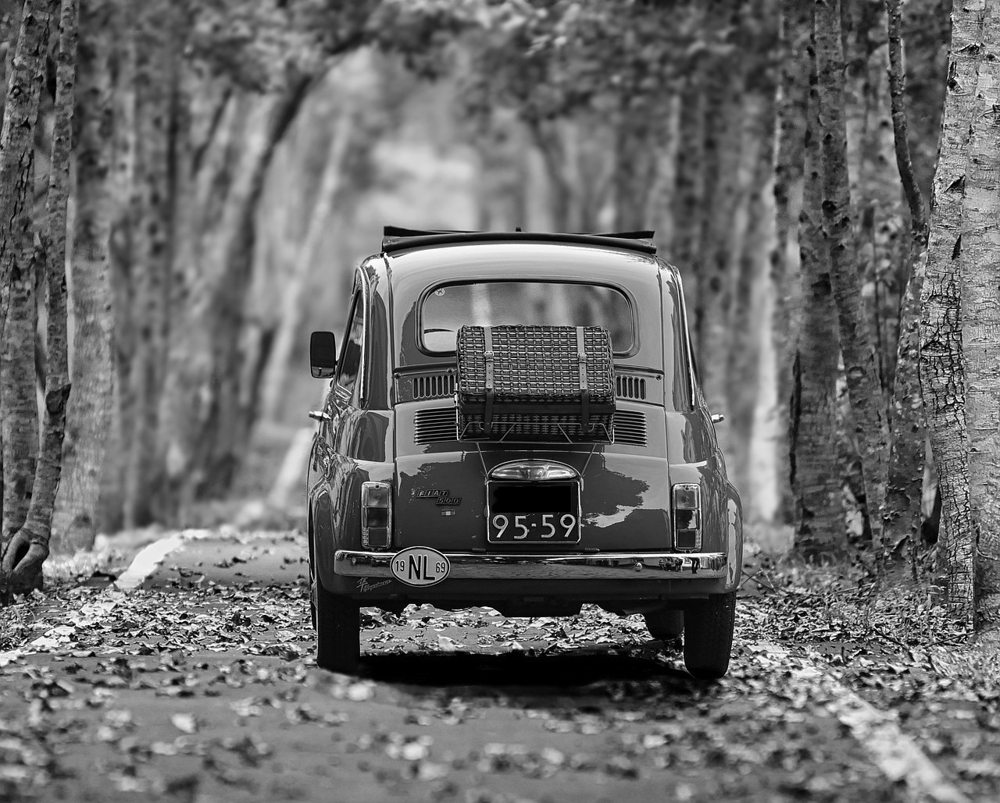

In [12]:
transforms.Grayscale()(image)

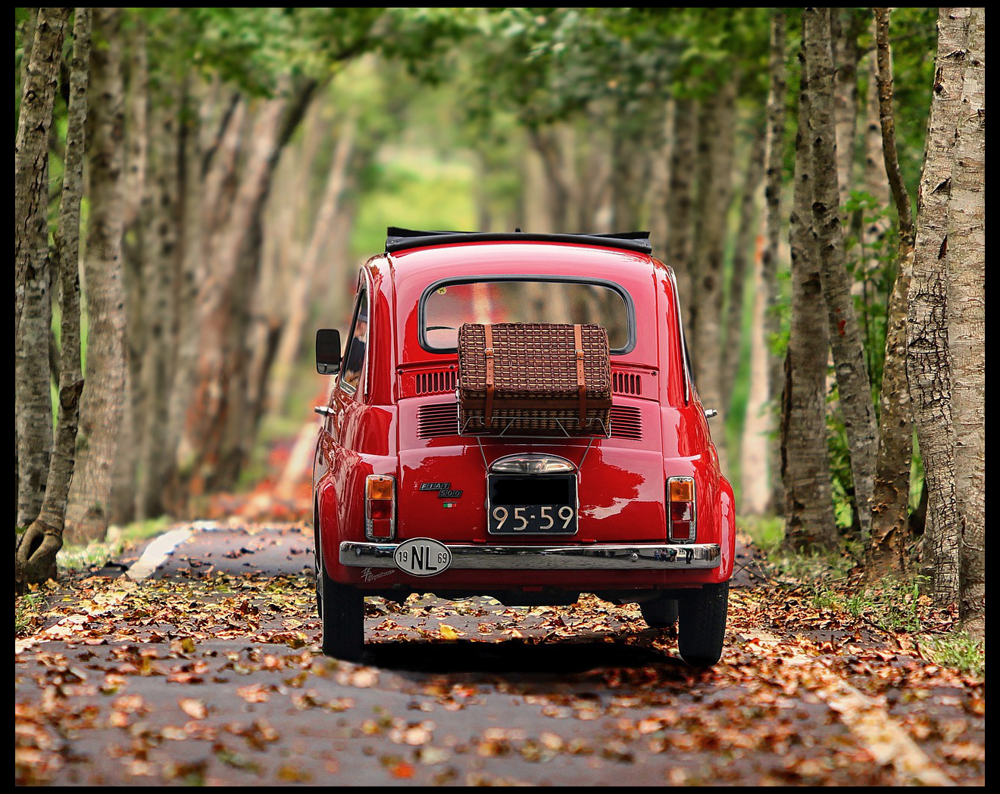

In [13]:
transforms.Pad(padding=(20,10))(image)

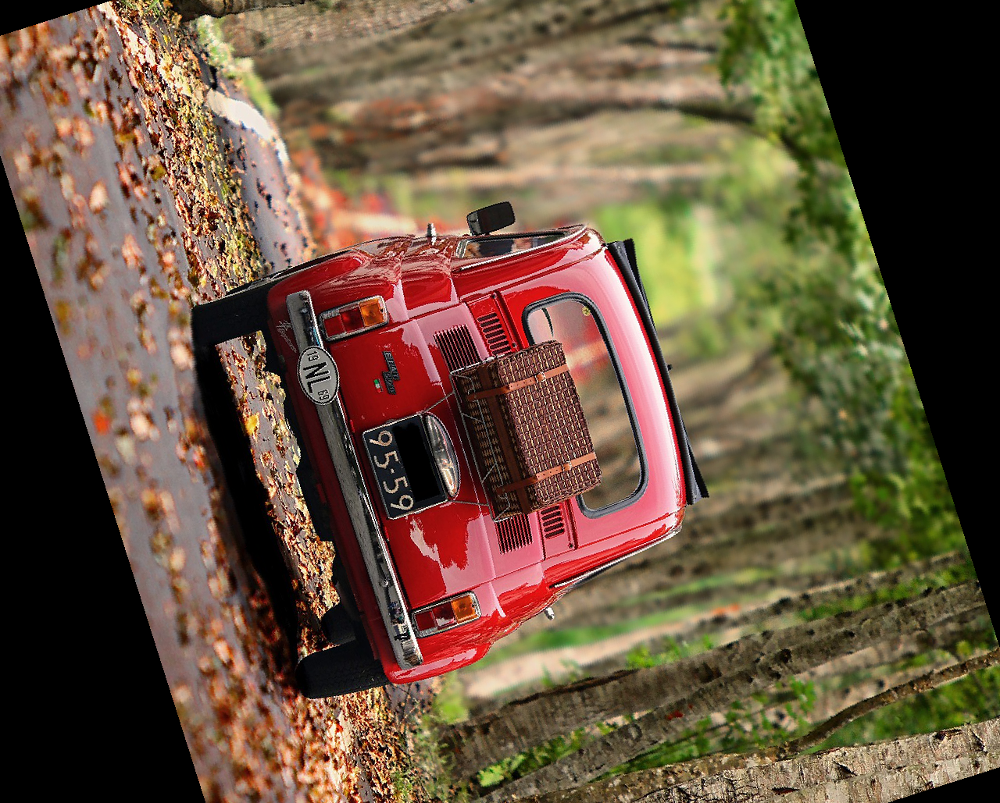

In [14]:
transforms.RandomAffine(degrees=90)(image)

In [15]:
transform_list = [
	transforms.RandomAffine(degrees=90),
	transforms.Pad(padding=(20,20))
]

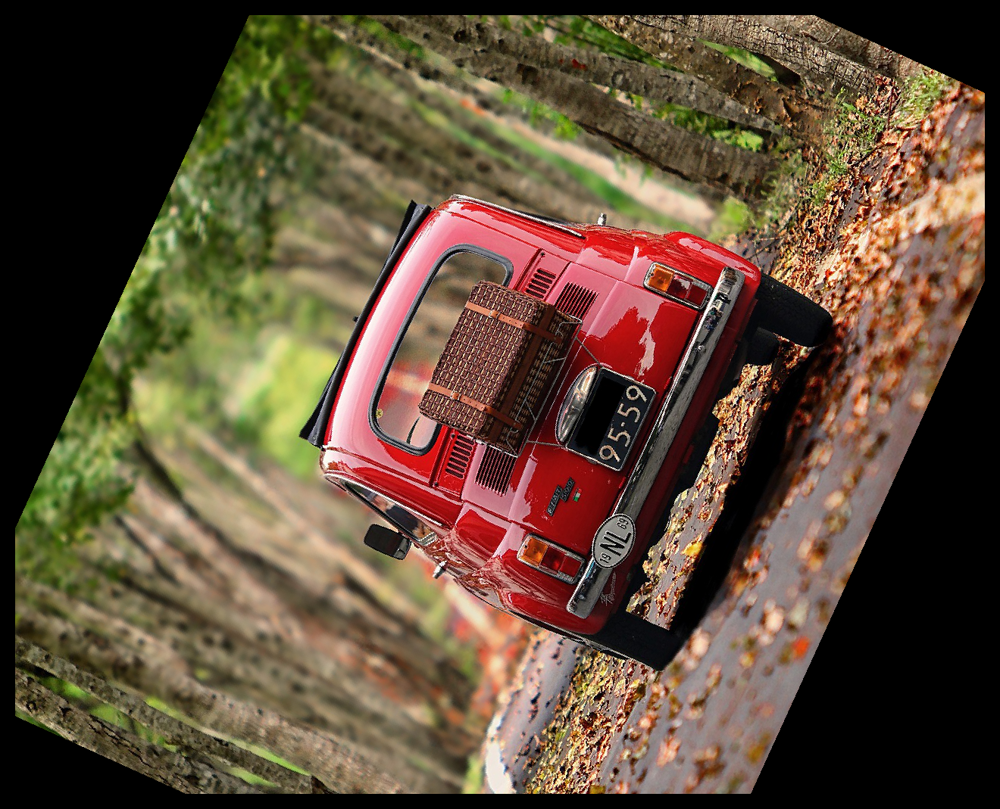

In [17]:
transforms.RandomApply(transforms=transform_list, p=0.5)(image)

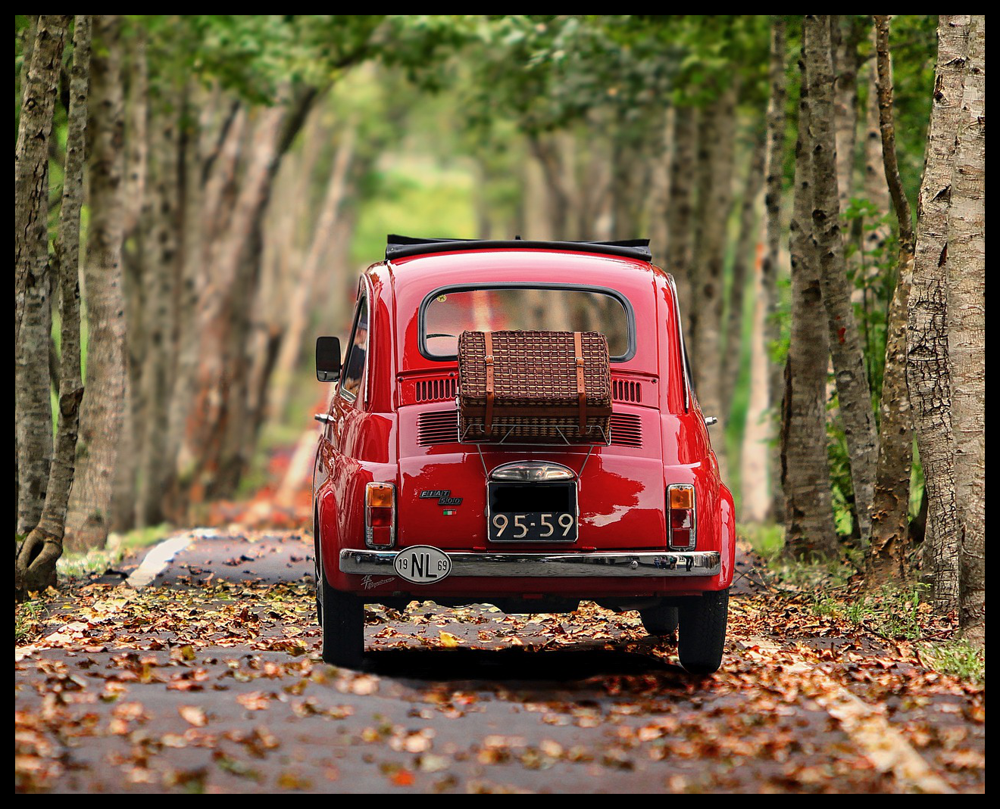

In [18]:
transforms.RandomChoice(transforms=transform_list)(image)

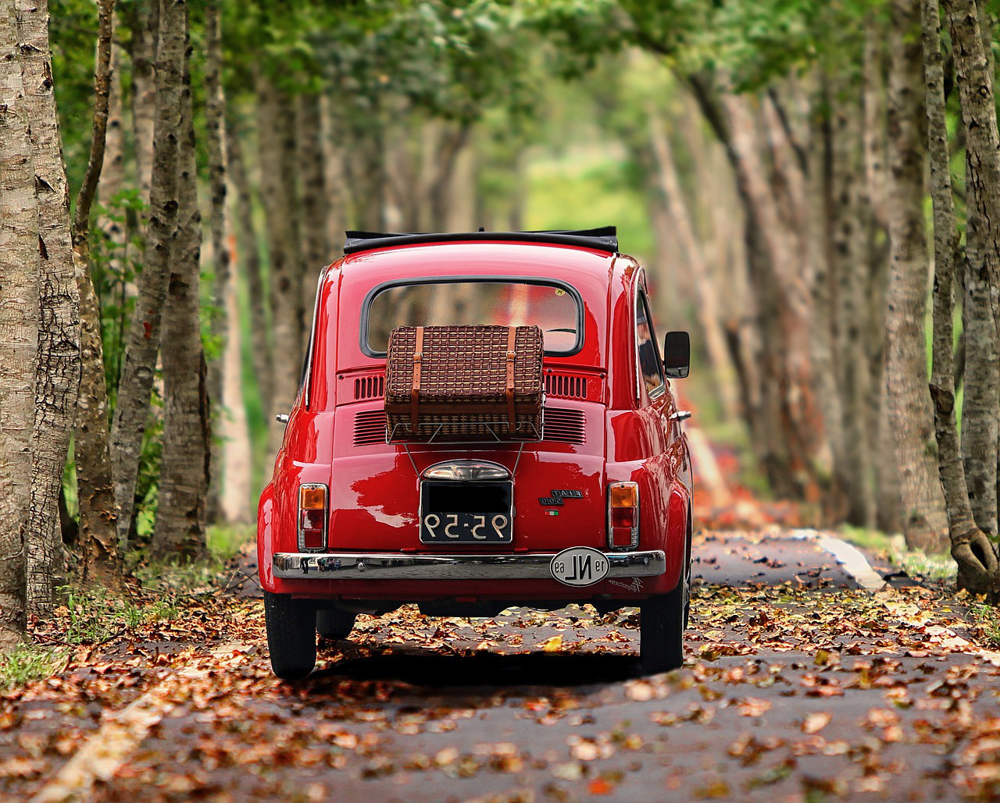

In [19]:
transforms.RandomHorizontalFlip(p=1.)(image)

## Training Example

In [20]:
cifar_dir = 'D:/zbDS/Project/Part8_DL/_dataset/cifar/'
train_dir = os.path.join(cifar_dir, "train")
test_dir = os.path.join(cifar_dir, "test")

In [21]:
transform = transforms.Compose([
	transforms.RandomResizedCrop(224),
	transforms.RandomHorizontalFlip(),
	transforms.ColorJitter(brightness=1, contrast=0, saturation=0, hue=0),
	transforms.Resize(224),
	transforms.ToTensor(),
	transforms.Normalize([0.485, 0.456, 0.406], [0.229, 0.224, 0.225])
])
test_transform = transforms.Compose([
	transforms.Resize(224),
	transforms.ToTensor(),
	transforms.Normalize([0.485, 0.456, 0.406], [0.229, 0.224, 0.225])
])

In [31]:
with open(os.path.join(cifar_dir, 'labels.txt'), 'r') as f:
    label_list = f.read().strip().split("\n")

In [23]:
class Dataset(torch.utils.data.Dataset):
    def __init__(self, data_paths, transform=None):
        super(Dataset).__init__()
        self.data_paths = data_paths
        self.transform = transform
    
    def __len__(self, ):
        return len(self.data_paths)
    
    
    # index를 입력하면 해당하는 데이터를 파싱해서 이미지와 레이블로 만들어 주는 메서드
    def __getitem__(self, idx):
        path = self.data_paths[idx]
        image = Image.open(path)
        label_name = path.split(".png")[0].split("_")[-1].strip()
        label = label_list.index(label_name)
        
        if self.transform:
            image = self.transform(image)
            
        return image, label

In [24]:
train_dataset = Dataset(data_paths=glob(train_dir + "/*.png"), transform=transform)
test_dataset = Dataset(data_paths=glob(test_dir + "/*.png"), transform=test_transform)

In [25]:
batch_size = 32

train_loader = torch.utils.data.DataLoader(
    train_dataset,
    batch_size=batch_size,
    shuffle=True
)
test_loader = torch.utils.data.DataLoader(
    test_dataset,
    batch_size=batch_size
)

In [26]:
class ResidualBlock(nn.Module):
    def __init__(self, in_channel, out_channel):
        super(ResidualBlock, self).__init__()

        self.in_channel, self.out_channel = in_channel, out_channel

        self.conv1 = nn.Conv2d(in_channel, out_channel, kernel_size=1, padding=0)
        self.conv2 = nn.Conv2d(out_channel, out_channel, kernel_size=3, padding=1)
        self.conv3 = nn.Conv2d(out_channel, out_channel, kernel_size=1, padding=0)

        if in_channel != out_channel:
            self.shortcut = nn.Sequential(
                nn.Conv2d(in_channel, out_channel, kernel_size=1, padding=0)
            )
        else:
            self.shortcut = nn.Sequential()

    def forward(self, x):
        out = F.relu(self.conv1(x))
        out = F.relu(self.conv2(out))
        out = F.relu(self.conv3(out))
        out = out + self.shortcut(x)
        return out
    
class ResNet(nn.Module):
    def __init__(self, color='gray'):
        super(ResNet, self).__init__()

        if color == "gray":
            self.conv1 = nn.Conv2d(1, 32, kernel_size=3, stride=1, padding=1)
        elif color == "rgb":
            self.conv1 = nn.Conv2d(3, 32, kernel_size=3, stride=1, padding=1)

        self.resblock1 = ResidualBlock(32, 64)
        self.resblock2 = ResidualBlock(64, 64)

        self.avgpool = nn.AdaptiveAvgPool2d((1,1))
        self.fc1 = nn.Linear(64, 64)
        self.fc2 = nn.Linear(64, 10)

    def forward(self, x):
        x = F.relu(self.conv1(x))
        x = F.max_pool2d(x, 2, 2)
        x = self.resblock1(x)
        x = self.resblock2(x)
        x = self.avgpool(x)
        x = torch.flatten(x,1)
        x = F.relu(self.fc1(x))
        x = self.fc2(x)
        x = F.log_softmax(x, dim=1)
        return x

In [27]:
model = ResNet(color='rgb')

In [32]:
def train_loop(dataloader, model, loss_fn, optimizer, epoch):
    model.train()
    size = len(dataloader)
    for batch, (x, y) in enumerate(dataloader):
        x, y = x.to(device), y.to(device)

        pred = model(x)
        loss = loss_fn(pred, y)

        optimizer.zero_grad()
        loss.backward()
        optimizer.step()

        if batch % 500 == 0:
            print(f"Epoch {epoch+1} : [{batch}/{size}] loss : {loss.item()}")

    return loss.item()


def test_loop(dataloader, model, loss_fn, optimizer):
    model.eval()
    test_loss = 0
    with torch.no_grad():
        for batch, (x, y) in enumerate(dataloader):
            x, y = x.to(device), y.to(device)
            output = model(x)
            test_loss += loss_fn(output, y, reduction='sum').item()
            
    test_loss /= len(dataloader.dataset)

    return test_loss

In [ ]:
optimizer = torch.optim.Adam(model.parameters(), lr=0.003)

for epoch in range(1):
    loss = train_loop(train_loader, model, F.nll_loss, optimizer, epoch)
    test_loss = test_loop(test_loader, model, F.nll_loss, optimizer)
    print(f"epoch:{epoch+1} --> loss : {loss},  test_loss : {test_loss}" )